In [141]:
import pandas as pd


import numpy as np
import pandas as pd
import cv2 

import matplotlib.pyplot as plt

import os
import os.path
import random 
from skimage.color import rgb2gray

import numpy as np
import pandas as pd
import cv2 
import scipy

import numpy as np
import matplotlib.pyplot as plt

import os
import os.path
import random 

from math import sqrt
from skimage import data
from skimage.feature import blob_log

import time

In [148]:
import matplotlib.pyplot as plt

def LOG(image, max_num, min_num): 
    #Reading image
    #image = cv2.imread(image)
    #Laplacian: Highlights regions of rapid intensity change
    blobsLOG = blob_log(rgb2gray(image), min_sigma = min_num, max_sigma=max_num, num_sigma=5, threshold=.1)
    #print(blobsLOG)
    # Computing radii
    blobsLOG[:, 2] = blobsLOG[:, 2] * sqrt(2)
    #print(blobsLOG)

    #Setting plot
    blobList = [blobsLOG]
    colors = ['yellow']
    titles = ['Laplacian of Gaussian']
    sequence = zip(blobList, colors, titles)

    fig, axes = plt.subplots(1, 2, figsize=(16, 9), sharex=True, sharey=True)

    ax = axes.ravel()
    
    #print("Loading image...")
    countofCircles = 0
    
    for index, (blobs, color, title) in enumerate(sequence):
        ax[index].set_title(title)
        ax[index].imshow(image, interpolation='nearest')
        for blob in blobs:
            y, x, r = blob
            c = plt.Circle((x, y), r, color=color, linewidth=2, fill=False)
            countofCircles=countofCircles+1
            ax[index].add_patch(c)
        ax[index].set_axis_off()
        
    plt.show()

def decide(image):
    count = LOGandDOG(image) 
    if (count > 3000):
        return('The image is focused.')
    else:
        return('The image is not focused.')


In [133]:
image = "Testing_Focus_Images/Tile_r1-c1_S_005_590829419.tif"
image = cv2.imread(image)
image = image[3000:3400, 5600:6000]
run_time_max = []
run_time_min = []
sigma = []

In [ ]:
for i in range(0,20):
    print(i) 
    start_time = time.time()
    LOG(image, a, 30)
    end = time.time()
    timea = end - start_time
    run_time_min.append(timea)
    sigma.append(a)
    a = a+2

0


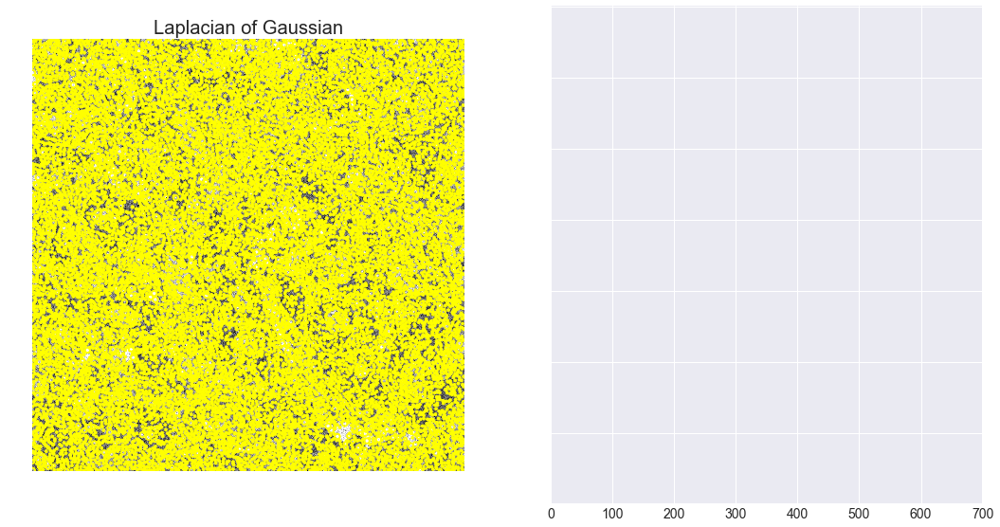

1


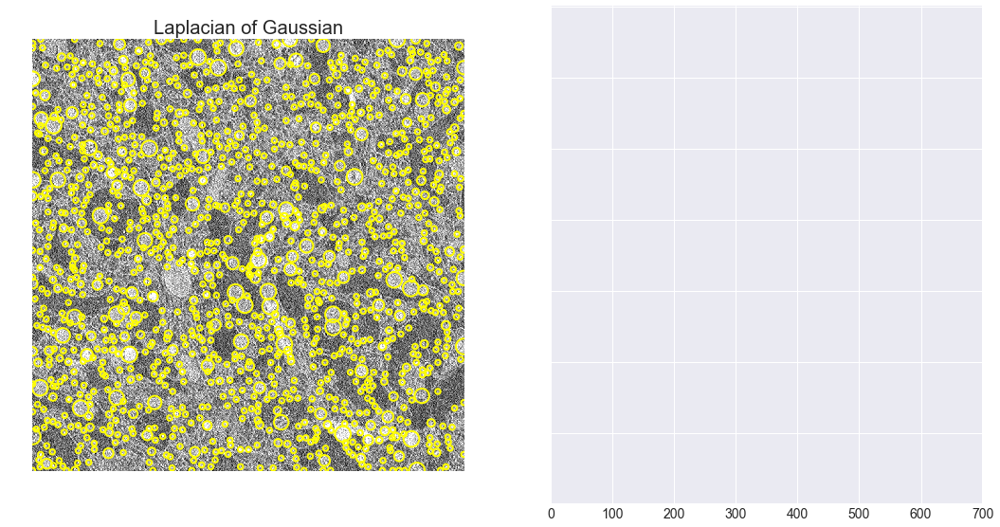

2


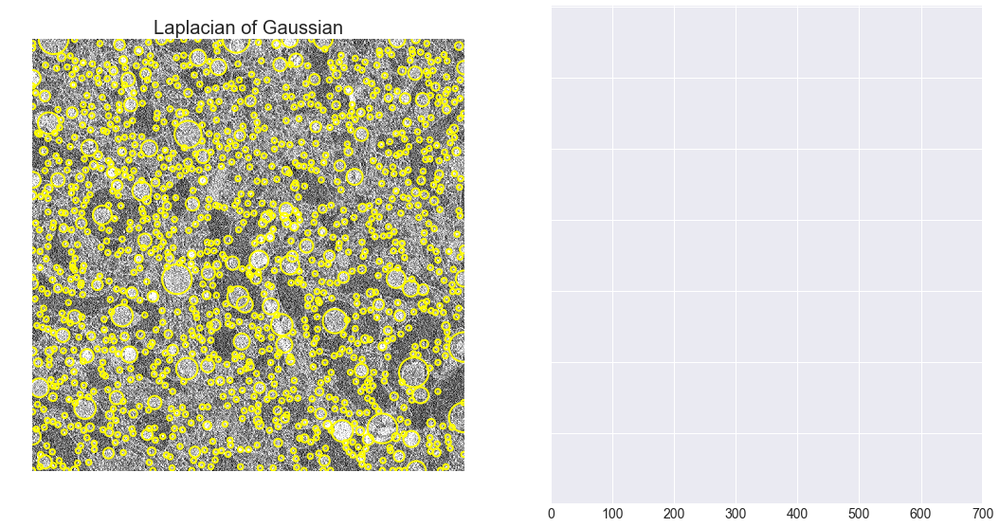

3


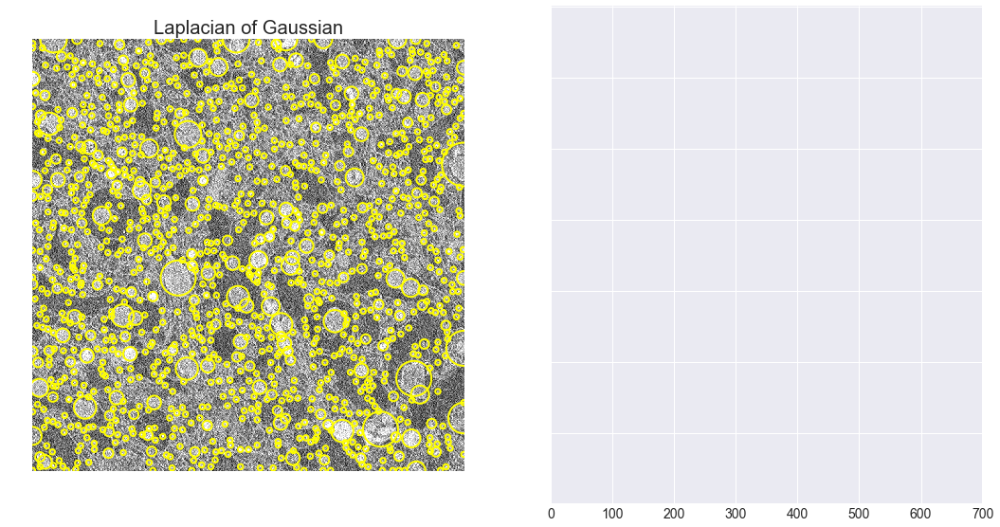

4


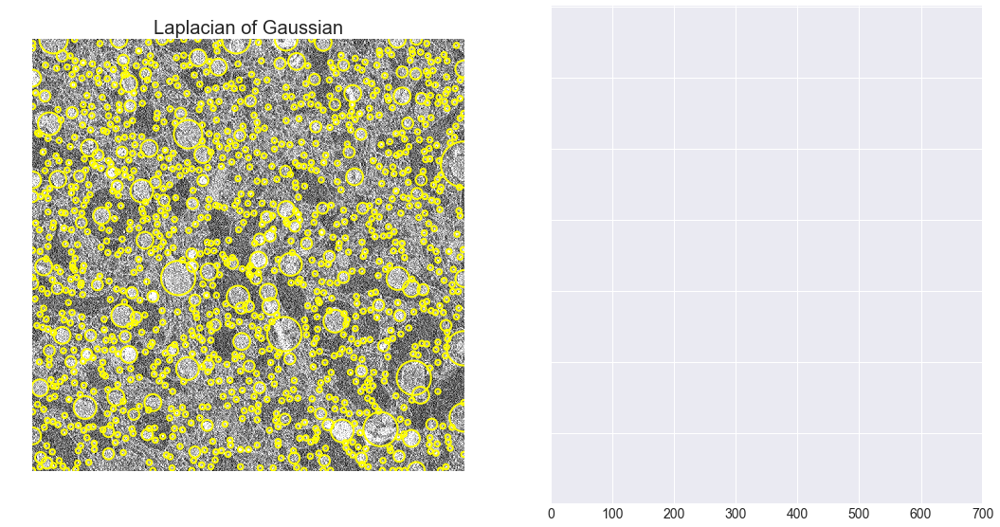

5


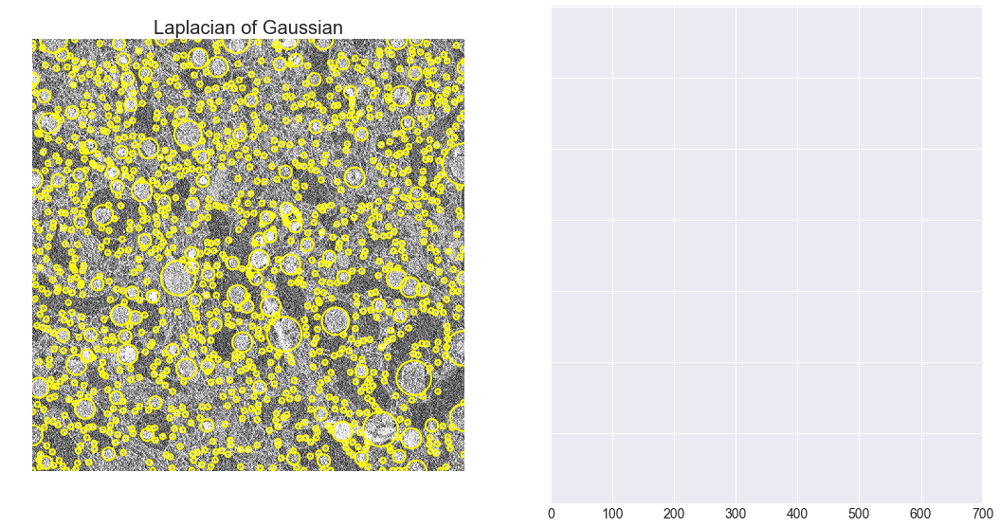

6


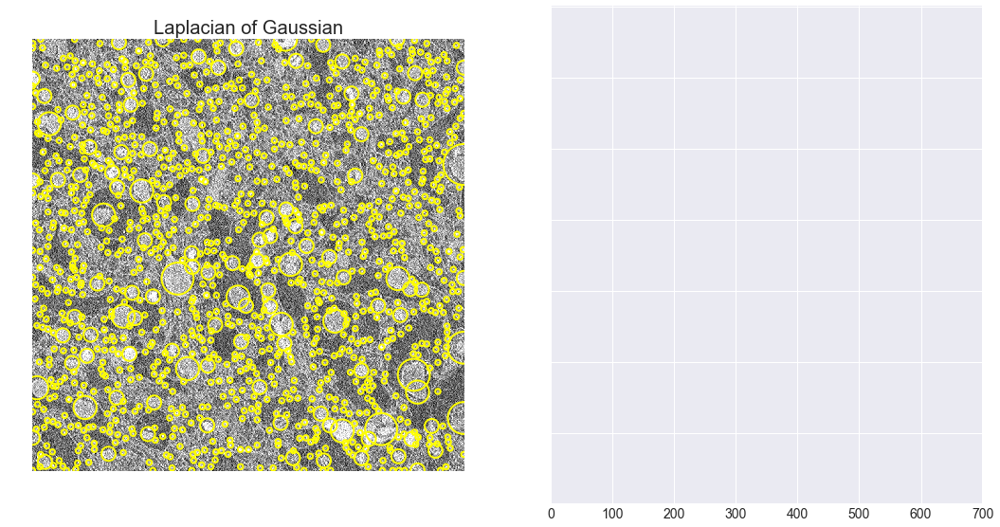

7


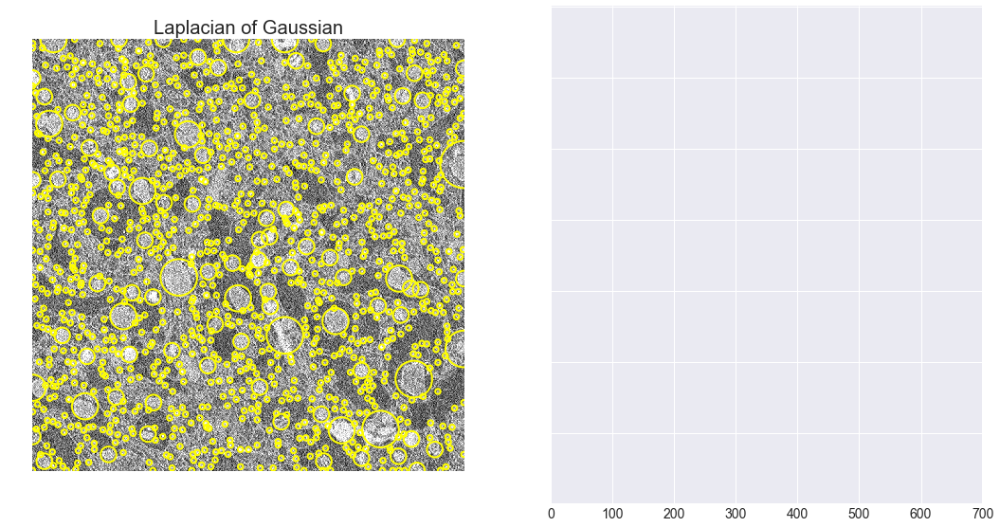

8


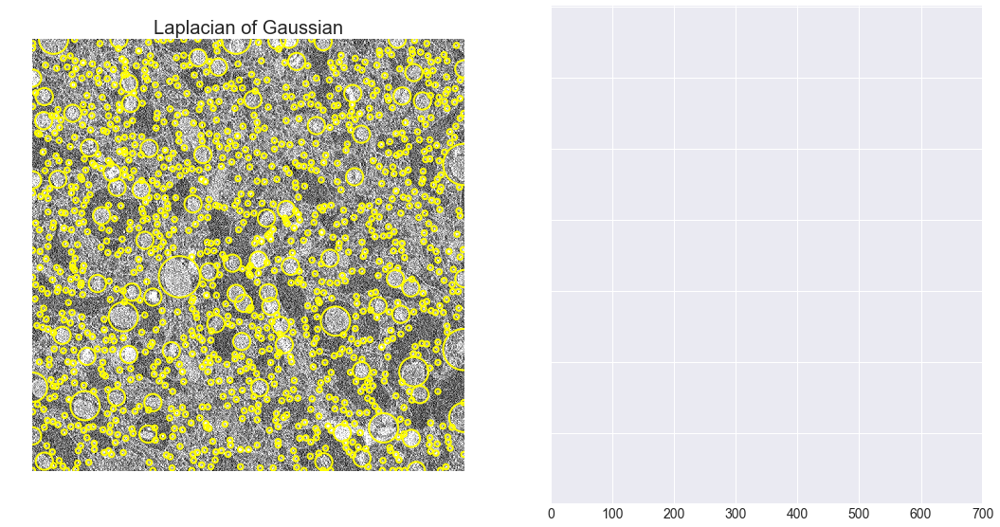

9


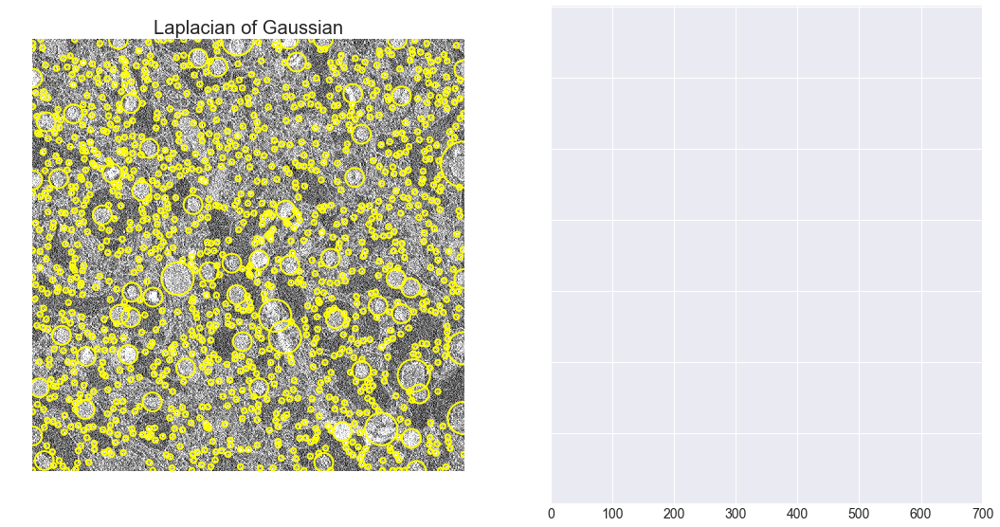

10


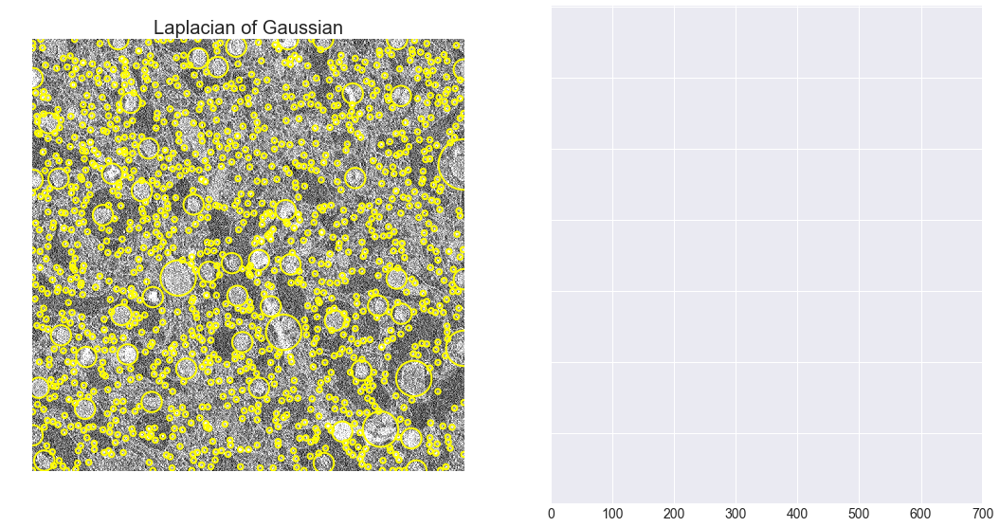

11


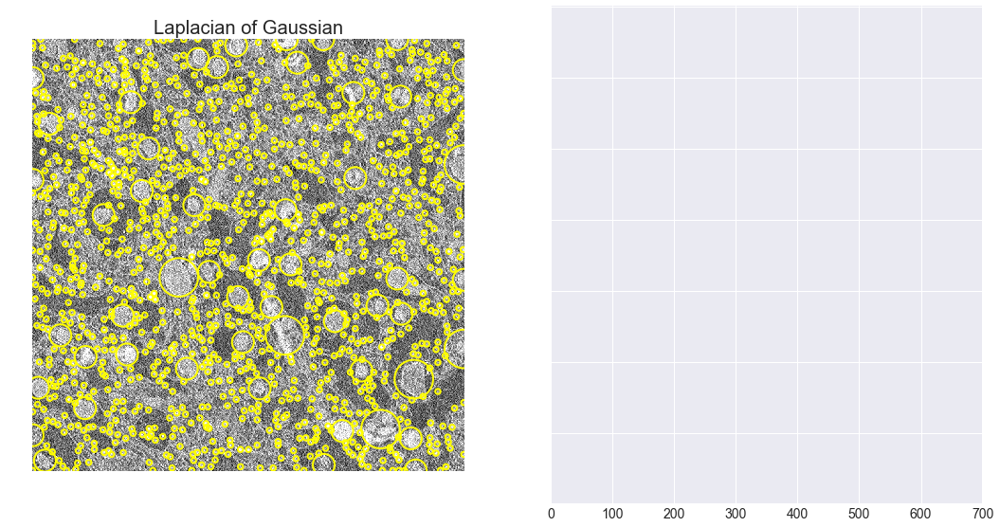

12


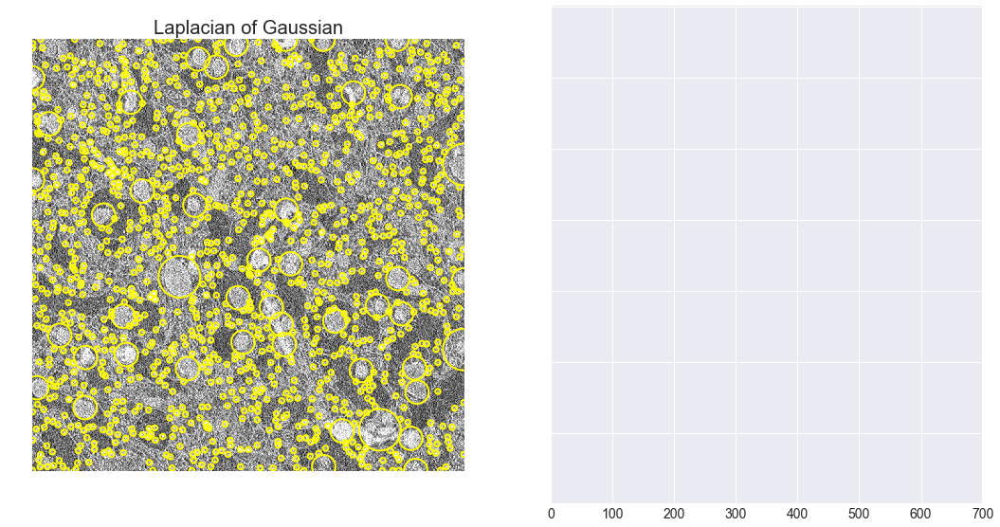

13


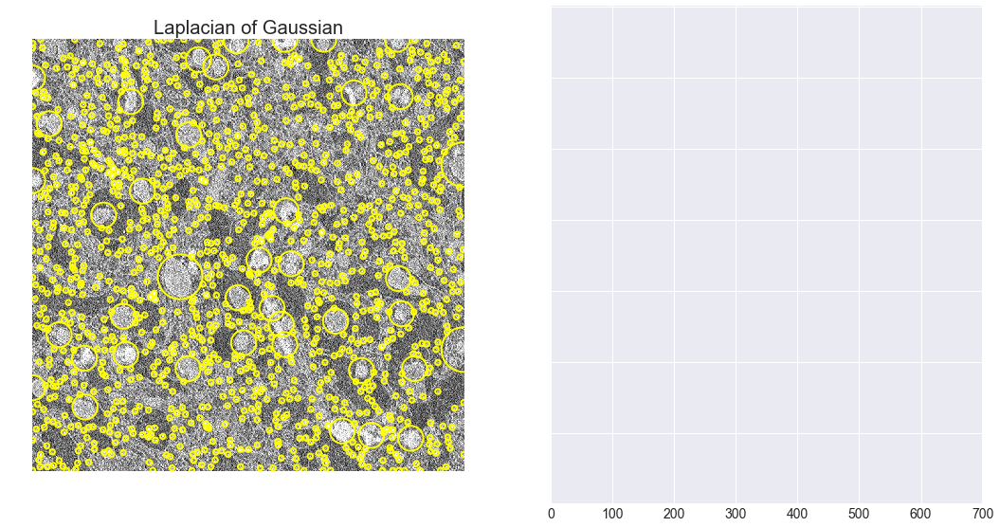

14


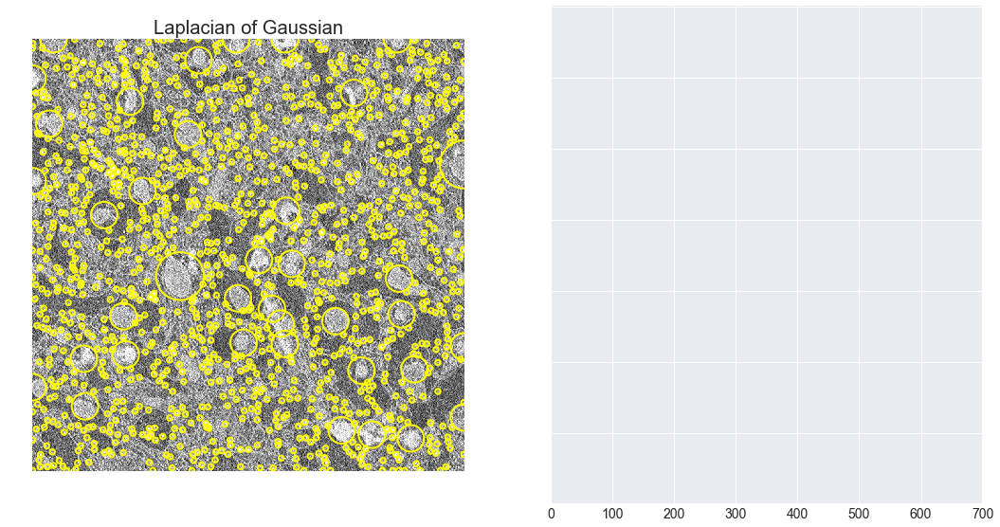

15


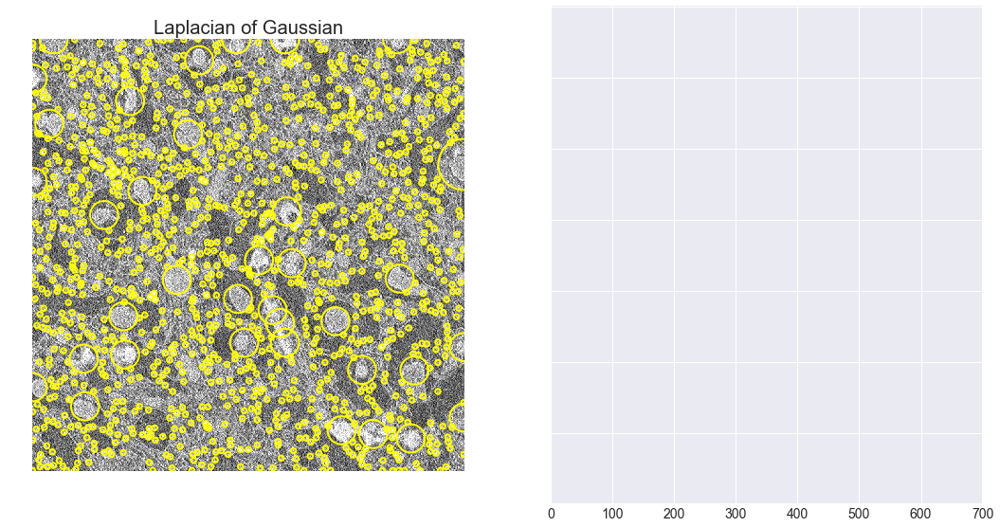

16


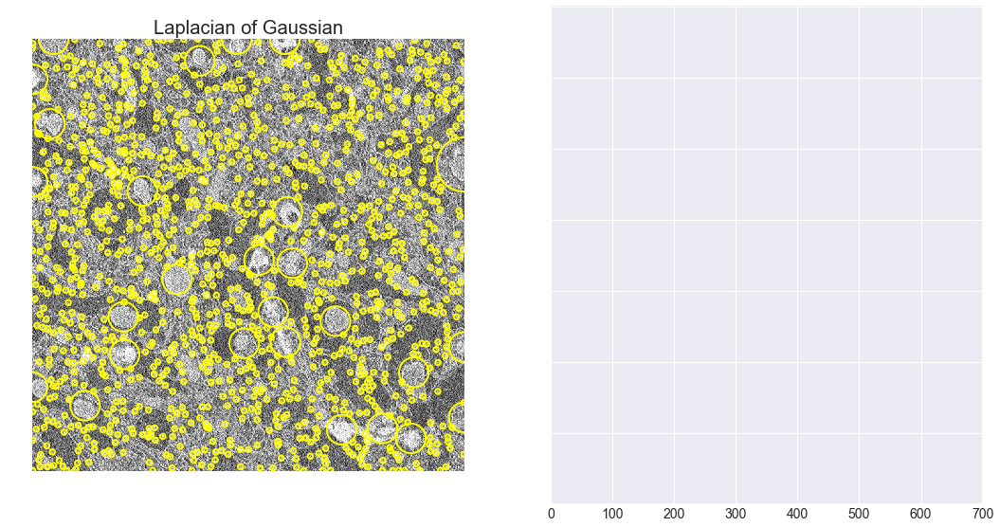

17


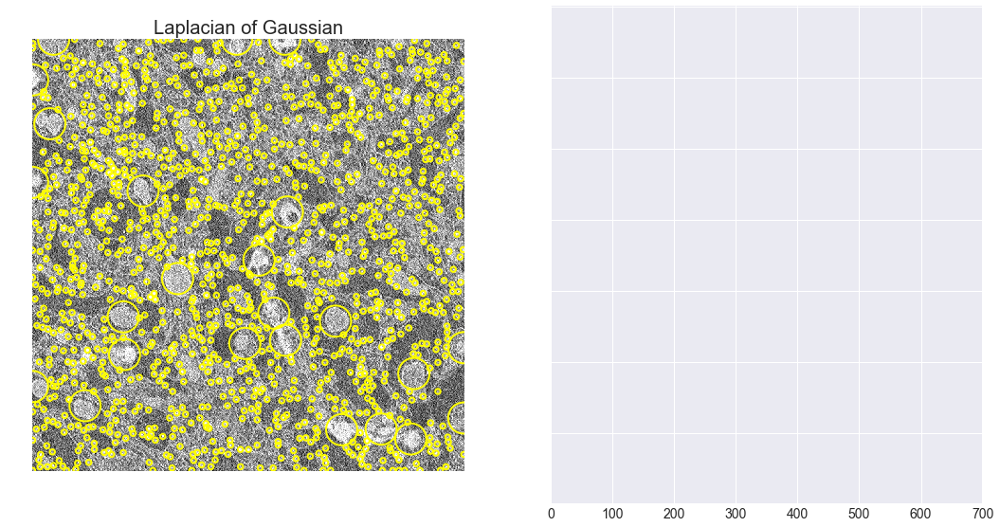

18


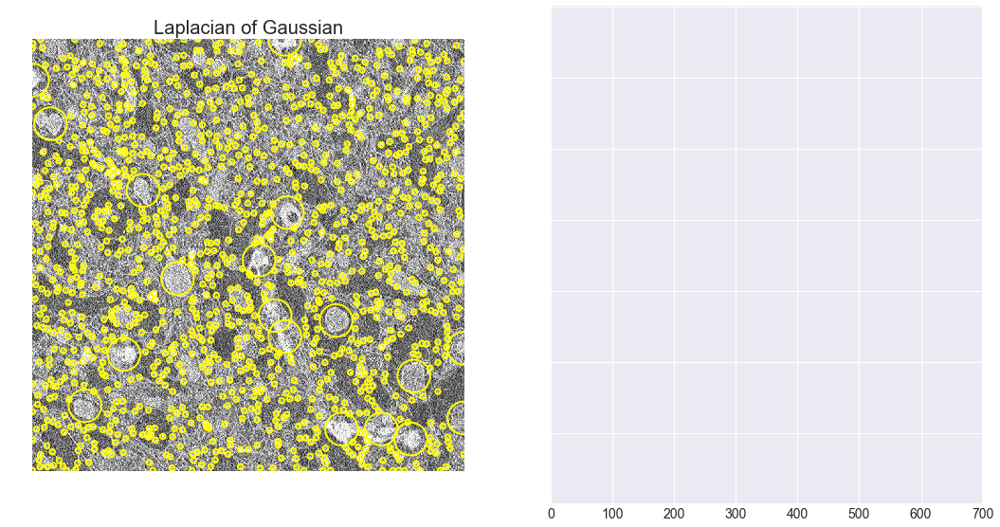

19


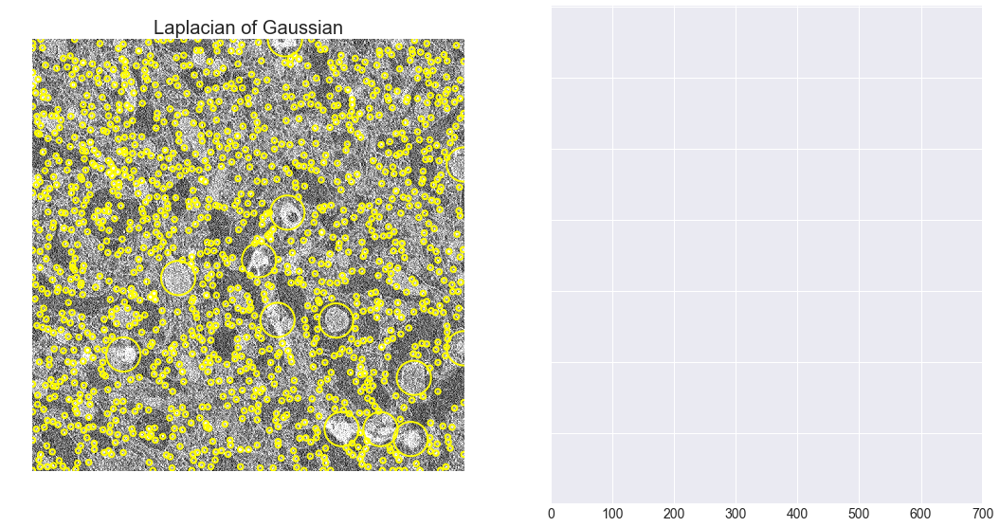

In [116]:
a = 1
b = 1

for i in range(0,20):
    print(i)
    sigma.append(b)
    start_time = time.time()
    LOG(image, 3, b)
    end = time.time()
    timae = end - start_time
    run_time_max.append(timae)
    b = b+8

In [117]:
#RunTimeGraph

In [126]:
sigma = [9, 17,
 25,
 33,
 41,
 49,
 57,
 65,
 73,
 81,
 89,
 97,
 105,
 113,
 121,
 129,
 137,
 145,
 153]

In [127]:
run_time_max = [2.1768300533294678,
 3.1167070865631104,
 3.028127908706665,
 3.357743263244629,
 3.706926107406616,
 4.1540021896362305,
 4.610618829727173,
 4.416931867599487,
 5.041368007659912,
 5.388861179351807,
 5.481234788894653,
 6.177463054656982,
 6.230561971664429,
 6.783377170562744,
 7.366121053695679,
 7.2874839305877686,
 7.27393102645874,
 7.708954095840454,
 8.46747088432312]

In [128]:
from mpl_toolkits import mplot3d

In [129]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

Text(0, 0.5, 'Run Time (Seconds)')

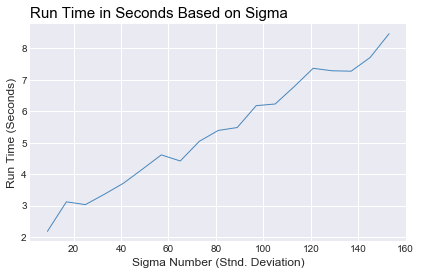

In [130]:

# style
plt.style.use('seaborn-darkgrid')
 
# create a color palette
palette = plt.get_cmap('Set1')
 
# multiple line plot
plt.plot(sigma, run_time_max, marker='', color=palette(1), linewidth=1, alpha=0.9)

 
# Add titles
plt.title("Run Time in Seconds Based on Sigma", loc='left', fontsize=15, fontweight=1, color='black')
plt.xlabel("Sigma Number (Stnd. Deviation)")
plt.ylabel("Run Time (Seconds)")

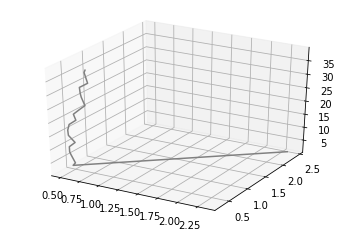

In [50]:
ax = plt.axes(projection='3d')

# Data for a three-dimensional line
zline = sigma
xline = run_time_max
yline = run_time_min
ax.plot3D(xline, yline, zline, 'gray')

In [64]:
#Guassian 3-D

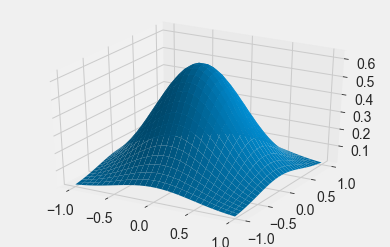

In [72]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

import numpy as np
from scipy.stats import multivariate_normal

x, y = np.mgrid[-1.0:1.0:30j, -1.0:1.0:30j]

# Need an (N, 2) array of (x, y) pairs.
xy = np.column_stack([x.flat, y.flat])

mu = np.array([0.0, 0.0])

sigma = np.array([.5, .5])
covariance = np.diag(sigma**2)

z = multivariate_normal.pdf(xy, mean=mu, cov=covariance)

# Reshape back to a (30, 30) grid.
z = z.reshape(x.shape)





fig = plt.figure()

ax = fig.add_subplot(111, projection='3d')



ax.plot_surface(x,y,z)
#ax.plot_wireframe(x,y,z)

plt.show()

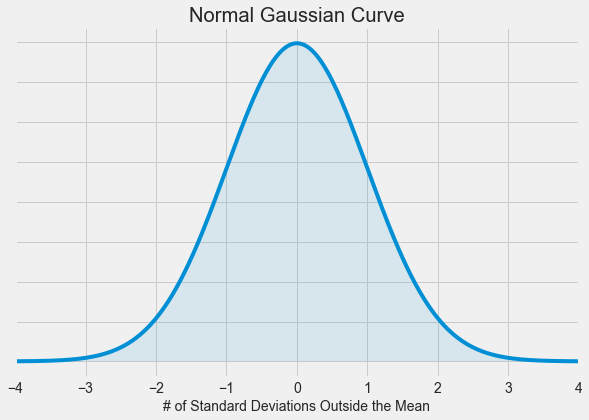

In [68]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm
#Gaussian 2-D
# define constants
mu = 998.8 
sigma = 73.10
x1 = 1
x2 = 30

# calculate the z-transform
z1 = ( x1 - mu ) / sigma
z2 = ( x2 - mu ) / sigma

x = np.arange(z1, z2, 0.001) # range of x in spec
x_all = np.arange(-10, 10, 0.001) # entire range of x, both in and out of spec
# mean = 0, stddev = 1, since Z-transform was calculated
y = norm.pdf(x,0,1)
y2 = norm.pdf(x_all,0,1)


# build the plot
fig, ax = plt.subplots(figsize=(9,6))
plt.style.use('fivethirtyeight')
ax.plot(x_all,y2)

ax.fill_between(x,y,0, alpha=0.3, color='b')
ax.fill_between(x_all,y2,0, alpha=0.1)
ax.set_xlim([-4,4])
ax.set_xlabel('# of Standard Deviations Outside the Mean', fontsize=14)
ax.set_yticklabels([])
ax.set_title('Normal Gaussian Curve')

plt.savefig('normal_curve.png', dpi=72, bbox_inches='tight')
plt.show()

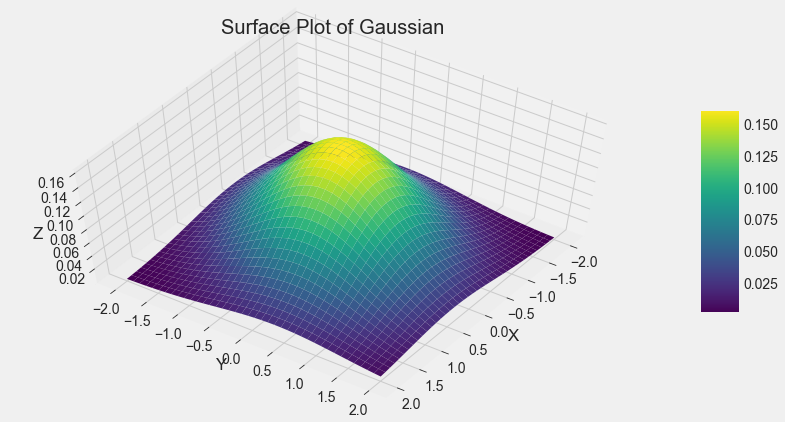

In [98]:
# Our 2-dimensional distribution will be over variables X and Y
N = 40
X = np.linspace(-2, 2, N)
Y = np.linspace(-2, 2, N)
X, Y = np.meshgrid(X, Y)

# Mean vector and covariance matrix
mu = np.array([0., 0.])
Sigma = np.array([[ 1. , 0.2], [0.2,  1.]])

# Pack X and Y into a single 3-dimensional array
pos = np.empty(X.shape + (2,))
pos[:, :, 0] = X
pos[:, :, 1] = Y

def multivariate_gaussian(pos, mu, Sigma):
    """Return the multivariate Gaussian distribution on array pos."""

    n = mu.shape[0]
    Sigma_det = np.linalg.det(Sigma)
    Sigma_inv = np.linalg.inv(Sigma)
    N = np.sqrt((2*np.pi)**n * Sigma_det)
    # This einsum call calculates (x-mu)T.Sigma-1.(x-mu) in a vectorized
    # way across all the input variables.
    fac = np.einsum('...k,kl,...l->...', pos-mu, Sigma_inv, pos-mu)

    return np.exp(-fac / 2) / N

# The distribution on the variables X, Y packed into pos.
Z = multivariate_gaussian(pos, mu, Sigma)

fig = plt.figure(figsize=(13, 7))
ax = plt.axes(projection='3d')
surf = ax.plot_surface(X, Y, Z, rstride=1, cstride=1, cmap='viridis', edgecolor='none')
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Surface Plot of Gaussian')
fig.colorbar(surf, shrink=0.5, aspect=5) # add color bar indicating the PDF
ax.view_init(60, 35)

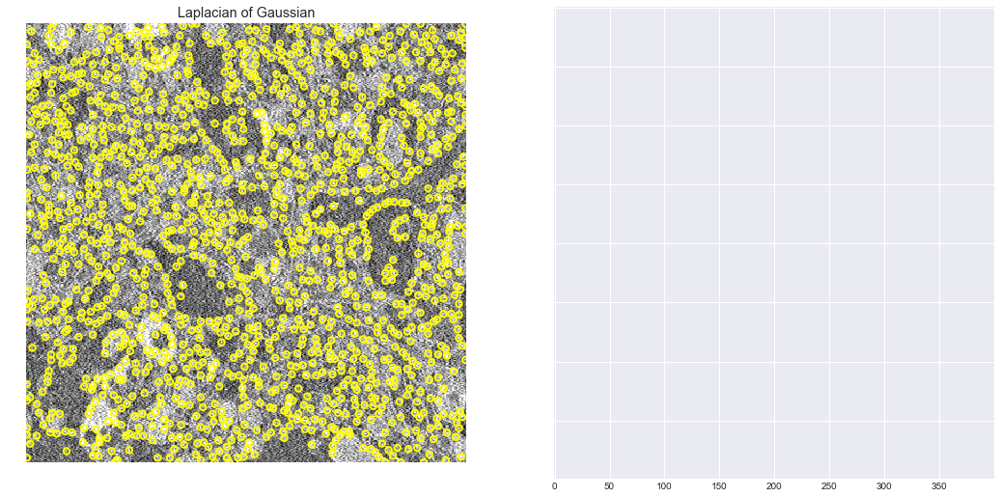

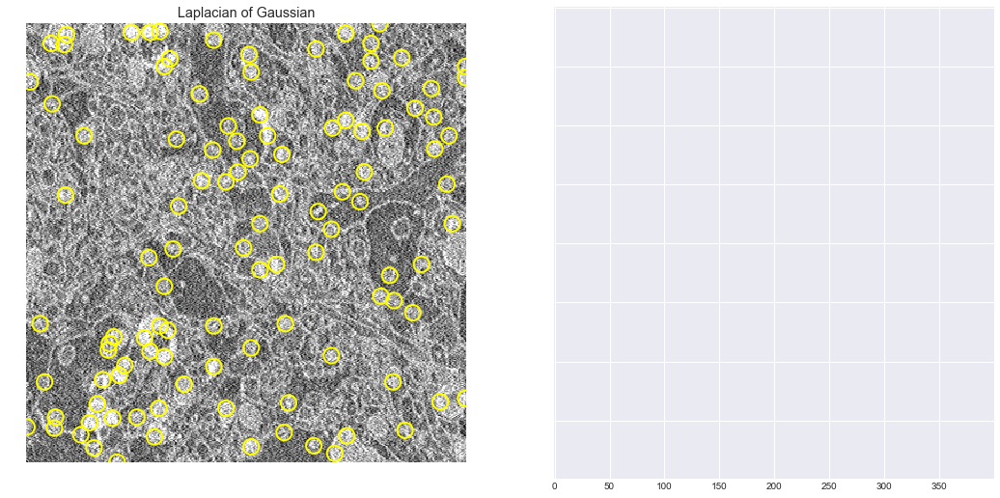

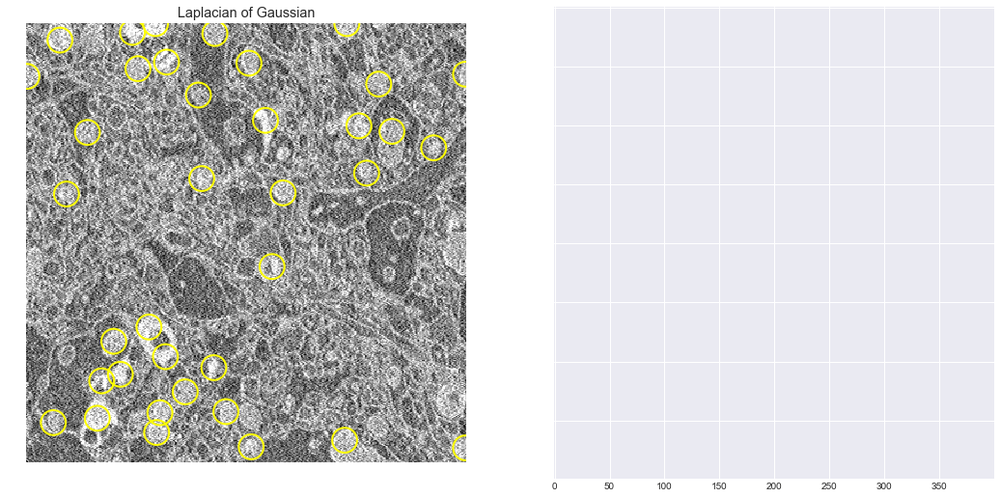

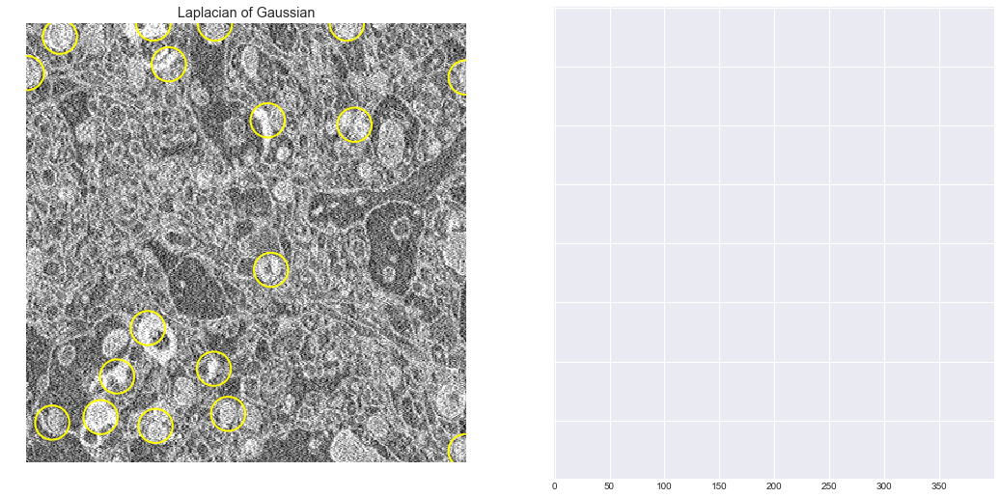

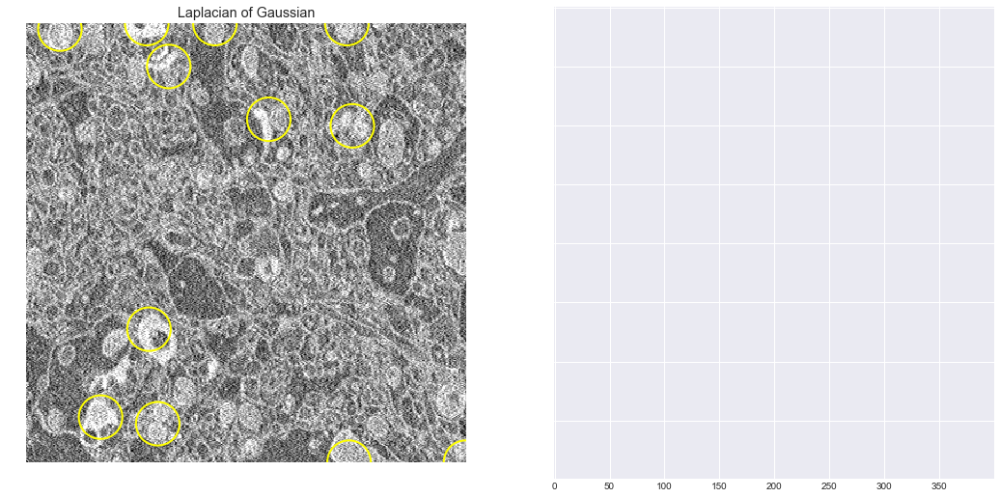

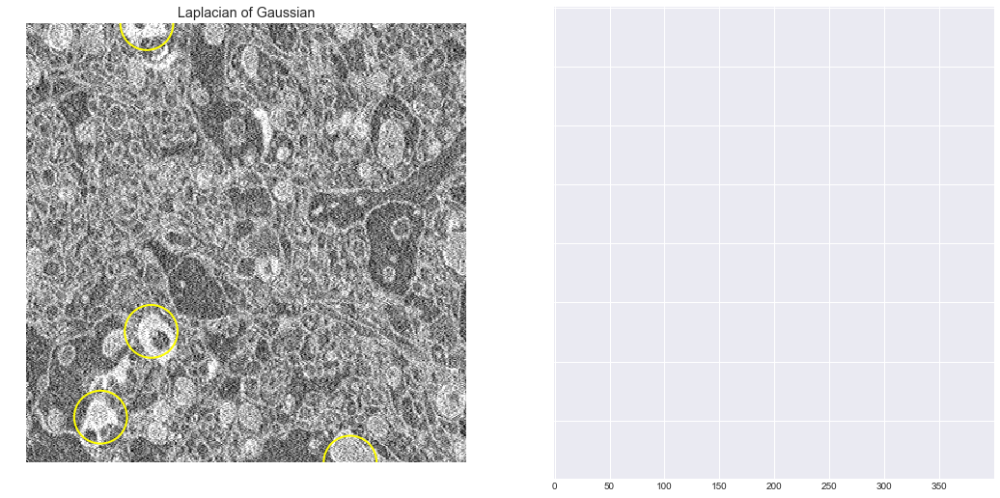

In [149]:
p = 2
for i in range(0,6):
    LOG(image,p,p)
    p = p + 3

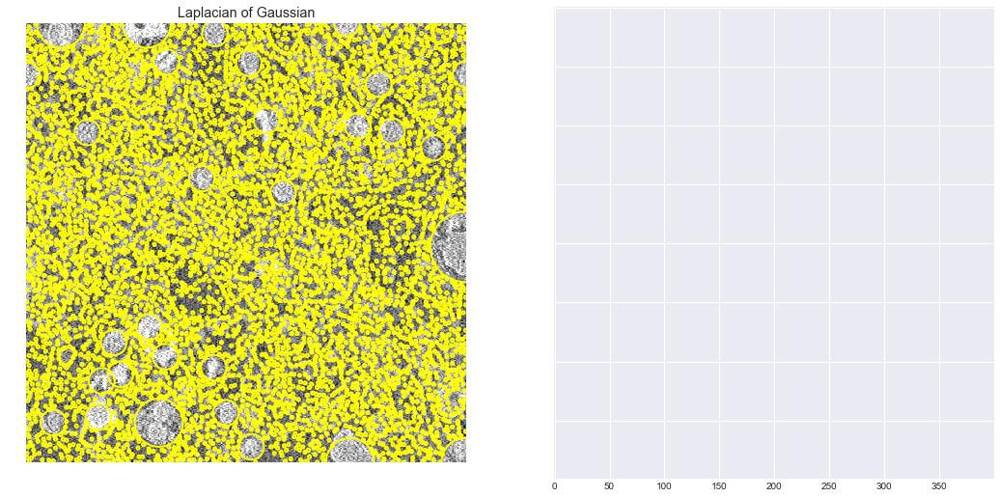

In [150]:
LOG(image,1,30)